# 03. Audio Generation

Though it is still computationally expensive to train a RAVE model, the audio generation with pre-trained RAVE models can be done in a fast manner using Python code here or in real-time with Max/MSP or PureData.

## Audio Generation using Python

The code here can be used to conduct Audio Generation/Manipulation tasks with the pre-trained RAVE models using Python, including:
- Unconditional Random Audio Generation
- Timbre Transfer
- Latent Space Manipulation

The generated audio that mentioned in report are saved in `./generated` folders.

*The trained models can be directly downloaded from Google Drive, please go to `'00-download-dataset-and-models.ipynb'` for detailed instructions.*

*The code is adapted from lecture notebook - week 6b audio generation with rave, which is originally created by [Teresa Pelinski](https://teresapelinski.com/) based on [this RAVE generation notebook](https://colab.research.google.com/github/hdparmar/AI-Music/blob/main/Latent_Soundings_workshop_RAVE.ipynb).*

### Install & Import

In [ ]:
# !pip install --quiet wget
# !pip install acids-rave
# !yes|conda install ffmpeg

In [67]:
import os
import sys
import wget
import torch

import numpy as np
import librosa as li
import librosa.display
import soundfile as sf
import IPython.display as ipd
import matplotlib.pyplot as plt

from math import floor
from scipy import signal
from src.latent_util import create_latent_interp, clamp

### Hyperparameters

In [136]:
latent_dim = 8 # 16 for piano, 8 for techno
sample_rate = 44100 # sample rate of the audio

### Load Model

In [129]:
pt_path = "./models" # folder where pretrained models will be downloaded/saved

In [138]:
generated_path = "generated" # folder where generated audio will be saved
if not os.path.exists(generated_path): # create the folder if it doesn't exist
    os.mkdir(generated_path)
    
pretrained_model = "rav_techno_4059" # select the pretrained model to use

model = torch.jit.load(f"{pt_path}/{pretrained_model}.ts" ).eval() # load model
torch.set_grad_enabled(False) # disable gradients

In [130]:
print(type(model))

<class 'torch.jit._script.RecursiveScriptModule'>


##### Download other pretrained models if needed
Some info on the pretrained models is available here: https://acids-ircam.github.io/rave_models_download

In [26]:
if not os.path.exists(pt_path): # create the folder if it doesn't exist
    os.mkdir(pt_path)
    
def bar_progress(current, total, width=80): # progress bar for wget
    progress_message = "Downloading: %d%% [%d / %d] bytes" % (current / total * 100, current, total)
    # Don't use print() as it will print in new line every time.
    sys.stdout.write("\r" + progress_message)
    sys.stdout.flush()

pretrained_models = ["nasa"] # list of available pretrained_models to download in https://acids-ircam.github.io/rave_models_download (you can select less if you want to spend less time on this cell)

for model in pretrained_models: # download pretrained models and save them in pt_path
    if not os.path.exists(os.path.join(pt_path, f"{model}.ts")): # only download if not already downloaded
        print(f"Downloading {model}.ts...")
        wget.download(f"https://play.forum.ircam.fr/rave-vst-api/get_model/{model}",f"{pt_path}/{model}.ts", bar=bar_progress)
    else:
        print(f"{model}.ts already downloaded")

Downloading: 100% [159284126 / 159284126] bytes

### Random Generation & Interpolation

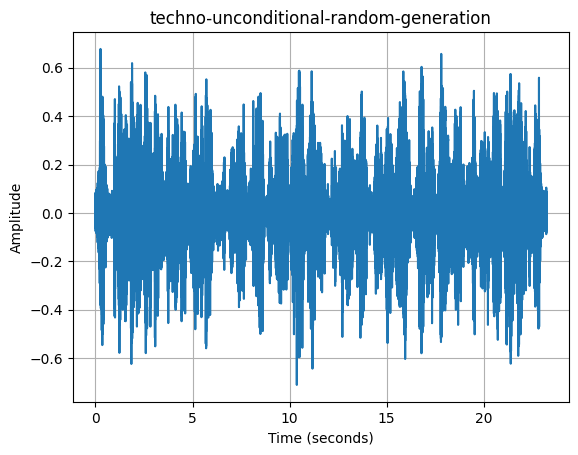

In [94]:
# random geneartion
generated_clips = []
for i in range(100):
    # Randomly sample latent space
    z = torch.randn(1,latent_dim,5)
    
    # Generate audio clip and append to list
    gen_audio_clip = model.decode(z)
    gen_audio_clip = gen_audio_clip.reshape(-1).cpu().numpy()
    generated_clips.append(gen_audio_clip)

# Concatonate list of audio clips into one array
generated_audio = np.concatenate(generated_clips)
ipd.display(ipd.Audio(data=generated_audio, rate=sample_rate)) # display audio widget

# plot the audio waveform
time = np.arange(0, len(generated_audio)) / sample_rate
plt.plot(time, generated_audio)
plt.xlabel("Time (seconds)")
plt.ylabel("Amplitude")
plt.title("techno-unconditional-random-generation") #change the title when using different model
plt.grid()
plt.show()

# display audio widget
ipd.display(ipd.Audio(data=generated_audio, rate=sample_rate))

/var/folders/w6/m517rm557tzcc05y2_zq5dcc0000gn/T/ipykernel_26073/872241707.py:11: UserWarning: amplitude_to_db was called on complex input so phase information will be discarded. To suppress this warning, call amplitude_to_db(np.abs(S)) instead.
  axs[1].pcolormesh(t1, f1[:100], np.abs(li.amplitude_to_db(Zxx1[:100, :],


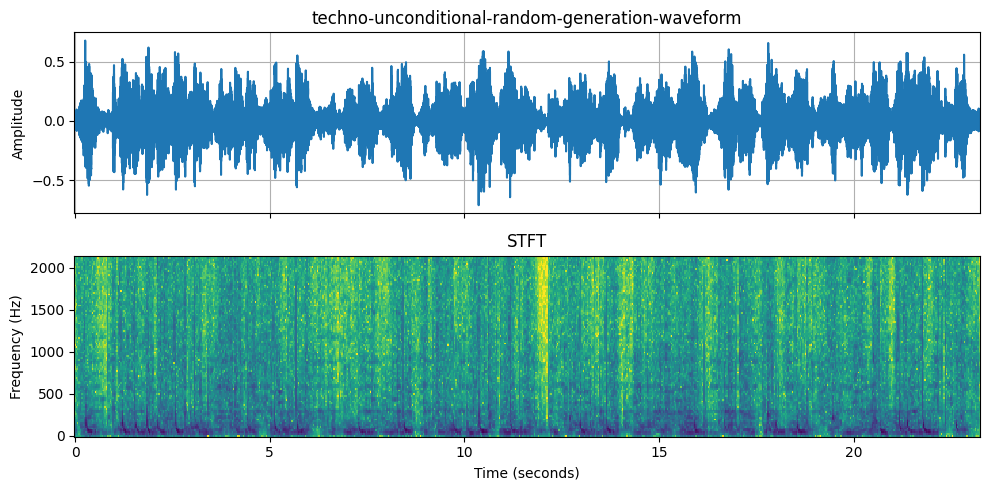

In [97]:
input_data = generated_audio
f1, t1, Zxx1 = signal.stft(input_data, fs=sample_rate, nperseg=2048, noverlap=512)

fig, axs = plt.subplots(2, 1, figsize=(10, 5), sharex=True)

axs[0].plot(time, input_data)
axs[0].set_ylabel("Amplitude")
axs[0].grid()
axs[0].set_title("techno-unconditional-random-generation-waveform") #change the title when using different model

axs[1].pcolormesh(t1, f1[:100], np.abs(li.amplitude_to_db(Zxx1[:100, :],
                                                       ref=np.max)))
axs[1].set_xlabel("Time (seconds)")
axs[1].set_title("STFT")
axs[1].set_ylabel("Frequency (Hz)")

plt.tight_layout()
plt.show()

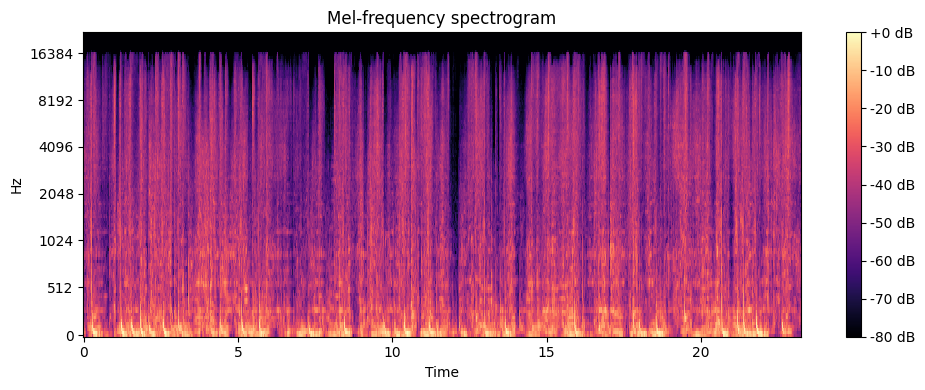

In [98]:
# Compute the mel-spectrogram
S = li.feature.melspectrogram(y=input_data, sr=sample_rate, n_fft=2048, hop_length=512, n_mels=128)
# Convert to dB
S_DB = li.power_to_db(S, ref=np.max)

# Plotting
plt.figure(figsize=(10, 4))

# Displaying the mel-spectrogram
li.display.specshow(S_DB, sr=sample_rate, hop_length=512, x_axis='time', y_axis='mel')

plt.colorbar(format='%+2.0f dB')
plt.title('Mel-frequency spectrogram')
plt.tight_layout()
plt.show()

In [99]:
# interpolation
latent_interp = create_latent_interp(intervals=50, z_dim=latent_dim)
interpolation_clips = []

for latent in latent_interp:
    # Convert to tensor and reshape for RAVE input
    latent = torch.tensor(latent)
    # This changes the shape from (128) to (1,128,1)
    latent = latent.unsqueeze(0).unsqueeze(2)
    
    # Generate audio clip and append to list
    gen_audio_clip = model.decode(z)
    gen_audio_clip = gen_audio_clip.reshape(-1).cpu().numpy()
    interpolation_clips.append(gen_audio_clip)

# Concatonate list of audio clips into one array
generated_audio = np.concatenate(interpolation_clips)
print(generated_audio.shape)
ipd.display(ipd.Audio(data=generated_audio, rate=sample_rate)) # display audio widget

(512000,)


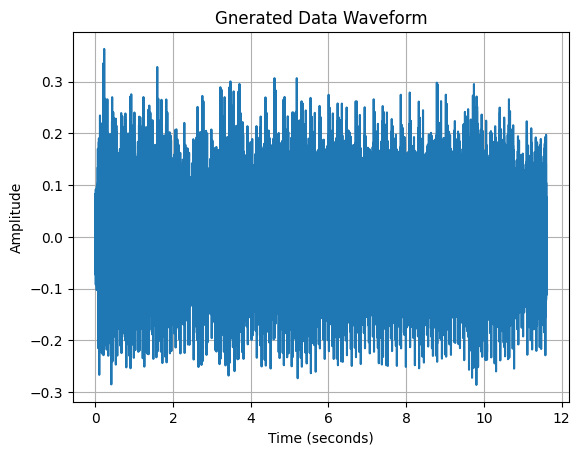

In [100]:
# Plot the audio waveform
time = np.arange(0, len(generated_audio)) / sample_rate
plt.plot(time, generated_audio)
plt.xlabel("Time (seconds)")
plt.ylabel("Amplitude")
plt.title("Gnerated Data Waveform")
plt.grid()
plt.show()

# Display audio widget
ipd.display(ipd.Audio(data=generated_audio, rate=sample_rate))

### Timbre Transfer

In [101]:
import librosa as li
import numpy as np
import matplotlib.pyplot as plt
import IPython.display as ipd

### Load an audio file and listen to it - Guitar

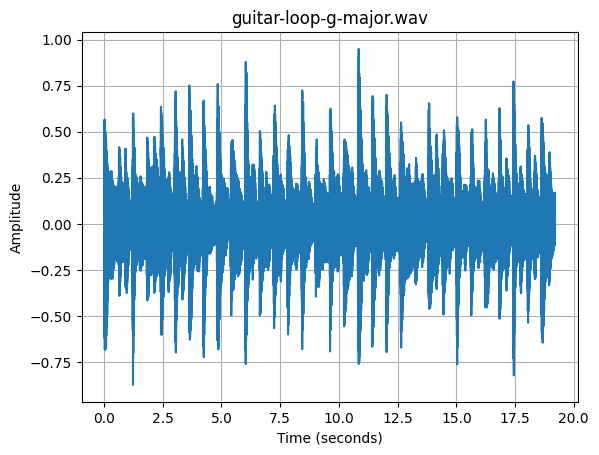

In [102]:
input_file = "./audio/guitar-loop-g-major.wav" 
input_data = li.load(input_file, sr=sample_rate)[0] # load input audio

time = np.arange(0, len(input_data)) / sample_rate # to obtain the time in seconds, we need to divide the sample index by the sample rate
plt.plot(time,input_data)
plt.xlabel("Time (seconds)")
plt.ylabel("Amplitude")
plt.title(input_file.split("/")[-1])
plt.grid()

ipd.display(ipd.Audio(data=input_data, rate=sample_rate)) # display audio widget

In [103]:
x = torch.from_numpy(input_data).reshape(1, 1, -1) # convert audio to tensor and add batch and channel dimensions
z = model.encode(x) # encode audio into latent representation

# synthesize audio from latent representation
y = model.decode(z).numpy() # decode latent representation and convert tensor to numpy array
y = y[:,0,:].reshape(-1) # remove batch and channel dimensions
y = y[abs(len(input_data)- len(y)):] # trim to match input length --> for some reason the output is a bit longer than the input

# save output audio
output_file =f'{generated_path}/techno_generated/{input_file.replace(".wav", f"_{pretrained_model}_generated.wav").split("/")[-1]}'
sf.write(output_file,y, sample_rate)

ipd.Audio(output_file) # display audio widget

We can compare the input and output sound wave and spectogram

/var/folders/w6/m517rm557tzcc05y2_zq5dcc0000gn/T/ipykernel_26073/1767128308.py:16: UserWarning: amplitude_to_db was called on complex input so phase information will be discarded. To suppress this warning, call amplitude_to_db(np.abs(S)) instead.
  axs[0,1].pcolormesh(t1, f1[:100], np.abs(li.amplitude_to_db(Zxx1[:100,:],
/var/folders/w6/m517rm557tzcc05y2_zq5dcc0000gn/T/ipykernel_26073/1767128308.py:18: UserWarning: amplitude_to_db was called on complex input so phase information will be discarded. To suppress this warning, call amplitude_to_db(np.abs(S)) instead.
  axs[1,1].pcolormesh(t2, f2[:100], np.abs(li.amplitude_to_db(Zxx2[:100,:],


Text(0, 0.5, 'Frequency (Hz)')

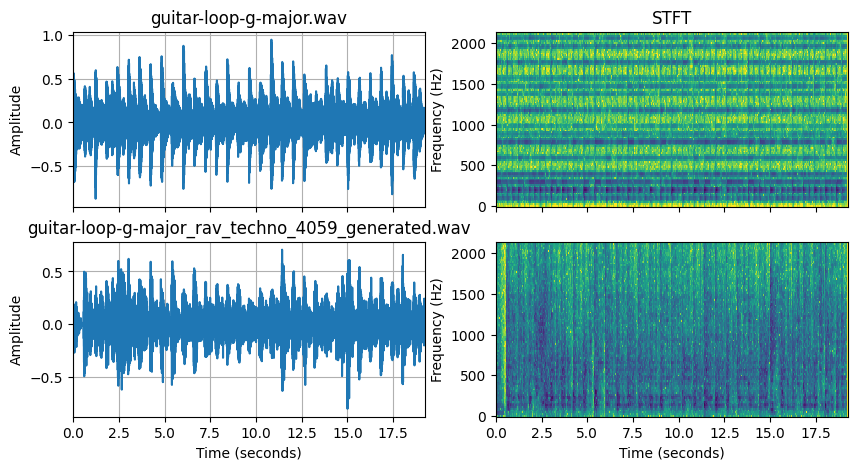

In [104]:
f1, t1, Zxx1 = signal.stft(input_data, fs=sample_rate, nperseg=2048, noverlap=512)
f2, t2, Zxx2 = signal.stft(y, fs=sample_rate, nperseg=2048, noverlap=512)

fig, axs = plt.subplots(2, 2,figsize=(10,5), sharex=True)

axs[0,0].plot(time,input_data)
axs[0,0].set_ylabel("Amplitude")
axs[0,0].grid()
axs[0,0].set_title(input_file.split("/")[-1])
axs[1,0].plot(time,y)
axs[1,0].set_ylabel("Amplitude")
axs[1,0].set_xlabel("Time (seconds)")
axs[1,0].grid()
axs[1,0].set_title(output_file.split("/")[-1])

axs[0,1].pcolormesh(t1, f1[:100], np.abs(li.amplitude_to_db(Zxx1[:100,:],
                                                       ref=np.max)))
axs[1,1].pcolormesh(t2, f2[:100], np.abs(li.amplitude_to_db(Zxx2[:100,:],
                                                       ref=np.max)))
axs[1,1].set_xlabel("Time (seconds)")
axs[0,1].set_title("STFT")
axs[0,1].set_ylabel("Frequency (Hz)")
axs[1,1].set_ylabel("Frequency (Hz)")

### Alter Latent Representation

In [105]:
print(z.shape) # the second dimension corresponds to the latent dimension, in this case, there's 8 latent dimensions

d0 = 1.09  # change in latent dimension 0
d1 = 3
d2 = 0.02
d3 = -0.5
# we leave dimensions 4-8 unchanged

z_modified = torch.clone(z) # copy latent representation
# bias latent dimensions (displace each sample representation by a constant value)
z_modified[:, 0] += torch.linspace(d0,d0, z.shape[-1])
z_modified[:, 1] += torch.linspace(d1,d1, z.shape[-1])
z_modified[:, 2] += torch.linspace(d2,d2, z.shape[-1])
z_modified[:, 3] += torch.linspace(d3,d3, z.shape[-1])

y_latent_1 = model.decode(z_modified).numpy() # decode latent representation and convert tensor to numpy array
y_latent_1 = y_latent_1[:,0,:].reshape(-1) # remove batch and channel dimensions
y_latent_1 = y_latent_1[abs(len(input_data)- len(y_latent_1)):] # trim to match input length
output_file = f'{generated_path}/techno_generated/{input_file.replace(".wav", f"_{pretrained_model}_latent_generated_1.wav").split("/")[-1]}'
sf.write(output_file,y_latent_1, sample_rate) # save output audio

ipd.Audio(output_file) # display audio widget

torch.Size([1, 8, 414])


### Sinusoid manipulation to latent

In [106]:
z_modified = torch.clone(z) # copy original latent representation

# bias latent dimensions with a sinusoidal function at 440 Hz
t = torch.linspace(0, z.shape[-1], z.shape[-1])
for idx in range(0, z.shape[1]): # for each latent dimension
    z_modified[:, idx] += torch.sin(440*2*np.pi*t)

y_latent_2 = model.decode(z_modified).numpy() # decode latent representation and convert tensor to numpy array
y_latent_2 = y_latent_2[:,0,:].reshape(-1) # remove batch and channel dimensions
y_latent_2 = y_latent_2[abs(len(input_data)- len(y_latent_2)):] # trim to match input length
output_file = f'{generated_path}/techno_generated/{input_file.replace(".wav", f"_{pretrained_model}_sinusoid_latent_generated_1.wav").split("/")[-1]}'
sf.write(output_file,y_latent_2, sample_rate) # save output audio

ipd.Audio(output_file) # display audio widget

### Load an audio file and listen to it - Human Voices

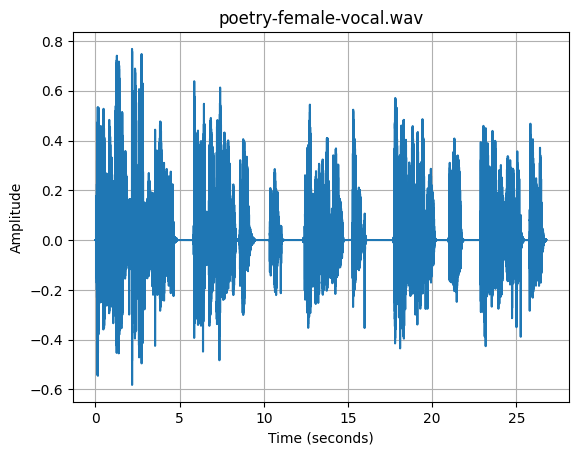

In [107]:
input_file = "./audio/poetry-female-vocal.wav" 
input_data = li.load(input_file, sr=sample_rate)[0] # load input audio

time = np.arange(0, len(input_data)) / sample_rate # to obtain the time in seconds, we need to divide the sample index by the sample rate
plt.plot(time,input_data)
plt.xlabel("Time (seconds)")
plt.ylabel("Amplitude")
plt.title(input_file.split("/")[-1])
plt.grid()

ipd.display(ipd.Audio(data=input_data, rate=sample_rate)) # display audio widget

In [108]:
x = torch.from_numpy(input_data).reshape(1, 1, -1) # convert audio to tensor and add batch and channel dimensions
z = model.encode(x) # encode audio into latent representation

# synthesize audio from latent representation
y = model.decode(z).numpy() # decode latent representation and convert tensor to numpy array
y = y[:,0,:].reshape(-1) # remove batch and channel dimensions
y = y[abs(len(input_data)- len(y)):] # trim to match input length --> for some reason the output is a bit longer than the input

# save output audio
output_file =f'{generated_path}/techno_generated/{input_file.replace(".wav", f"_{pretrained_model}_generated.wav").split("/")[-1]}'
sf.write(output_file,y, sample_rate)

ipd.Audio(output_file) # display audio widget

/var/folders/w6/m517rm557tzcc05y2_zq5dcc0000gn/T/ipykernel_26073/1767128308.py:16: UserWarning: amplitude_to_db was called on complex input so phase information will be discarded. To suppress this warning, call amplitude_to_db(np.abs(S)) instead.
  axs[0,1].pcolormesh(t1, f1[:100], np.abs(li.amplitude_to_db(Zxx1[:100,:],
/var/folders/w6/m517rm557tzcc05y2_zq5dcc0000gn/T/ipykernel_26073/1767128308.py:18: UserWarning: amplitude_to_db was called on complex input so phase information will be discarded. To suppress this warning, call amplitude_to_db(np.abs(S)) instead.
  axs[1,1].pcolormesh(t2, f2[:100], np.abs(li.amplitude_to_db(Zxx2[:100,:],


Text(0, 0.5, 'Frequency (Hz)')

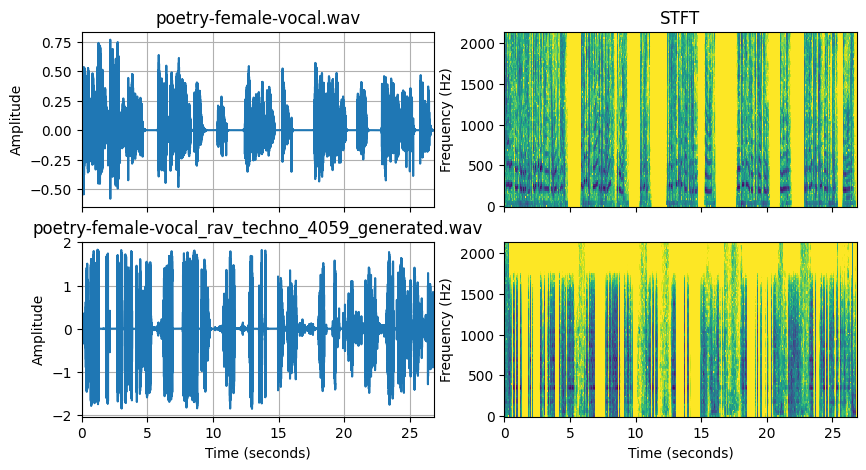

In [109]:
f1, t1, Zxx1 = signal.stft(input_data, fs=sample_rate, nperseg=2048, noverlap=512)
f2, t2, Zxx2 = signal.stft(y, fs=sample_rate, nperseg=2048, noverlap=512)

fig, axs = plt.subplots(2, 2,figsize=(10,5), sharex=True)

axs[0,0].plot(time,input_data)
axs[0,0].set_ylabel("Amplitude")
axs[0,0].grid()
axs[0,0].set_title(input_file.split("/")[-1])
axs[1,0].plot(time,y)
axs[1,0].set_ylabel("Amplitude")
axs[1,0].set_xlabel("Time (seconds)")
axs[1,0].grid()
axs[1,0].set_title(output_file.split("/")[-1])

axs[0,1].pcolormesh(t1, f1[:100], np.abs(li.amplitude_to_db(Zxx1[:100,:],
                                                       ref=np.max)))
axs[1,1].pcolormesh(t2, f2[:100], np.abs(li.amplitude_to_db(Zxx2[:100,:],
                                                       ref=np.max)))
axs[1,1].set_xlabel("Time (seconds)")
axs[0,1].set_title("STFT")
axs[0,1].set_ylabel("Frequency (Hz)")
axs[1,1].set_ylabel("Frequency (Hz)")

### Load an audio file and listen to it - Percussion

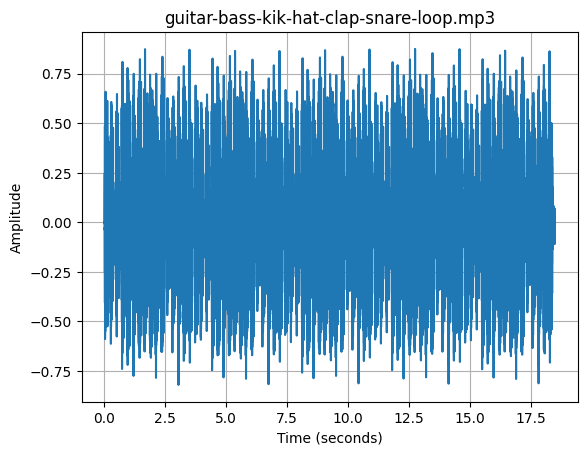

In [131]:
input_file = "./audio/guitar-bass-kik-hat-clap-snare-loop.mp3" 
input_data = li.load(input_file, sr=sample_rate)[0] # load input audio

time = np.arange(0, len(input_data)) / sample_rate # to obtain the time in seconds, we need to divide the sample index by the sample rate
plt.plot(time,input_data)
plt.xlabel("Time (seconds)")
plt.ylabel("Amplitude")
plt.title(input_file.split("/")[-1])
plt.grid()

ipd.display(ipd.Audio(data=input_data, rate=sample_rate)) # display audio widget

In [132]:
x = torch.from_numpy(input_data).reshape(1, 1, -1) # convert audio to tensor and add batch and channel dimensions
z = model.encode(x) # encode audio into latent representation

# synthesize audio from latent representation
y = model.decode(z).numpy() # decode latent representation and convert tensor to numpy array
y = y[:,0,:].reshape(-1) # remove batch and channel dimensions
y = y[abs(len(input_data)- len(y)):] # trim to match input length --> for some reason the output is a bit longer than the input

# save output audio
output_file =f'{generated_path}/techno_generated/{input_file.replace(".mp3", f"_{pretrained_model}_generated.wav").split("/")[-1]}'
sf.write(output_file,y, sample_rate)

ipd.Audio(output_file) # display audio widget

### Load an audio file and listen to it - Xylophon

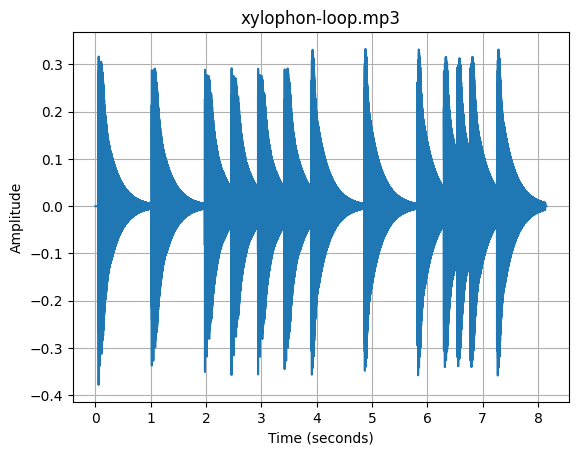

In [112]:
input_file = "./audio/xylophon-loop.mp3"
input_data = li.load(input_file, sr=sample_rate)[0] # load input audio

time = np.arange(0, len(input_data)) / sample_rate # to obtain the time in seconds, we need to divide the sample index by the sample rate
plt.plot(time,input_data)
plt.xlabel("Time (seconds)")
plt.ylabel("Amplitude")
plt.title(input_file.split("/")[-1])
plt.grid()

ipd.display(ipd.Audio(data=input_data, rate=sample_rate)) # display audio widget

In [114]:
x = torch.from_numpy(input_data).reshape(1, 1, -1) # convert audio to tensor and add batch and channel dimensions
z = model.encode(x) # encode audio into latent representation

# synthesize audio from latent representation
y = model.decode(z).numpy() # decode latent representation and convert tensor to numpy array
y = y[:,0,:].reshape(-1) # remove batch and channel dimensions
y = y[abs(len(input_data)- len(y)):] # trim to match input length --> for some reason the output is a bit longer than the input

# save output audio
output_file =f'{generated_path}/techno_generated/{input_file.replace(".mp3", f"_{pretrained_model}_generated.wav").split("/")[-1]}'
sf.write(output_file,y, sample_rate)

ipd.Audio(output_file) # display audio widget

In [115]:
print(z.shape) # the second dimension corresponds to the latent dimension, in this case, there's 8 latent dimensions

d0 = 1.09  # change in latent dimension 0
d1 = 3
d2 = 0.02
d3 = -0.5
# we leave dimensions 4-8 unchanged

z_modified = torch.clone(z) # copy latent representation
# bias latent dimensions (displace each sample representation by a constant value)
z_modified[:, 0] += torch.linspace(d0,d0, z.shape[-1])
z_modified[:, 1] += torch.linspace(d1,d1, z.shape[-1])
z_modified[:, 2] += torch.linspace(d2,d2, z.shape[-1])
z_modified[:, 3] += torch.linspace(d3,d3, z.shape[-1])

y_latent_1 = model.decode(z_modified).numpy() # decode latent representation and convert tensor to numpy array
y_latent_1 = y_latent_1[:,0,:].reshape(-1) # remove batch and channel dimensions
y_latent_1 = y_latent_1[abs(len(input_data)- len(y_latent_1)):] # trim to match input length
output_file = f'{generated_path}/techno_generated/{input_file.replace(".mp3", f"_{pretrained_model}_latent_generated_1.wav").split("/")[-1]}'
sf.write(output_file,y_latent_1, sample_rate) # save output audio

ipd.Audio(output_file) # display audio widget

torch.Size([1, 8, 176])


In [116]:
z_modified = torch.clone(z) # copy original latent representation

# bias latent dimensions with a sinusoidal function at 440 Hz
t = torch.linspace(0, z.shape[-1], z.shape[-1])
for idx in range(0, z.shape[1]): # for each latent dimension
    z_modified[:, idx] += torch.sin(440*2*np.pi*t)

y_latent_2 = model.decode(z_modified).numpy() # decode latent representation and convert tensor to numpy array
y_latent_2 = y_latent_2[:,0,:].reshape(-1) # remove batch and channel dimensions
y_latent_2 = y_latent_2[abs(len(input_data)- len(y_latent_2)):] # trim to match input length
output_file = f'{generated_path}/techno_generated/{input_file.replace(".mp3", f"_{pretrained_model}_sinusoid_latent_generated_1.wav").split("/")[-1]}'
sf.write(output_file,y_latent_2, sample_rate) # save output audio

ipd.Audio(output_file) # display audio widget

### Load an audio file and listen to it - Hiphop

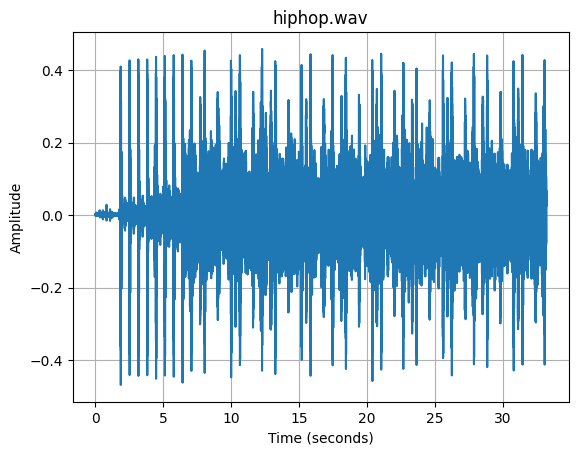

In [139]:
input_file = "./audio/hiphop.wav"
input_data = li.load(input_file, sr=sample_rate)[0] # load input audio

time = np.arange(0, len(input_data)) / sample_rate # to obtain the time in seconds, we need to divide the sample index by the sample rate
plt.plot(time,input_data)
plt.xlabel("Time (seconds)")
plt.ylabel("Amplitude")
plt.title(input_file.split("/")[-1])
plt.grid()

ipd.display(ipd.Audio(data=input_data, rate=sample_rate)) # display audio widget

In [140]:
x = torch.from_numpy(input_data).reshape(1, 1, -1) # convert audio to tensor and add batch and channel dimensions
z = model.encode(x) # encode audio into latent representation

# synthesize audio from latent representation
y = model.decode(z).numpy() # decode latent representation and convert tensor to numpy array
y = y[:,0,:].reshape(-1) # remove batch and channel dimensions
y = y[abs(len(input_data)- len(y)):] # trim to match input length --> for some reason the output is a bit longer than the input

# save output audio
output_file =f'{generated_path}/techno_generated/{input_file.replace(".wav", f"_{pretrained_model}_generated.wav").split("/")[-1]}'
sf.write(output_file,y, sample_rate)

ipd.Audio(output_file) # display audio widget

/var/folders/w6/m517rm557tzcc05y2_zq5dcc0000gn/T/ipykernel_26073/1767128308.py:16: UserWarning: amplitude_to_db was called on complex input so phase information will be discarded. To suppress this warning, call amplitude_to_db(np.abs(S)) instead.
  axs[0,1].pcolormesh(t1, f1[:100], np.abs(li.amplitude_to_db(Zxx1[:100,:],
/var/folders/w6/m517rm557tzcc05y2_zq5dcc0000gn/T/ipykernel_26073/1767128308.py:18: UserWarning: amplitude_to_db was called on complex input so phase information will be discarded. To suppress this warning, call amplitude_to_db(np.abs(S)) instead.
  axs[1,1].pcolormesh(t2, f2[:100], np.abs(li.amplitude_to_db(Zxx2[:100,:],


Text(0, 0.5, 'Frequency (Hz)')

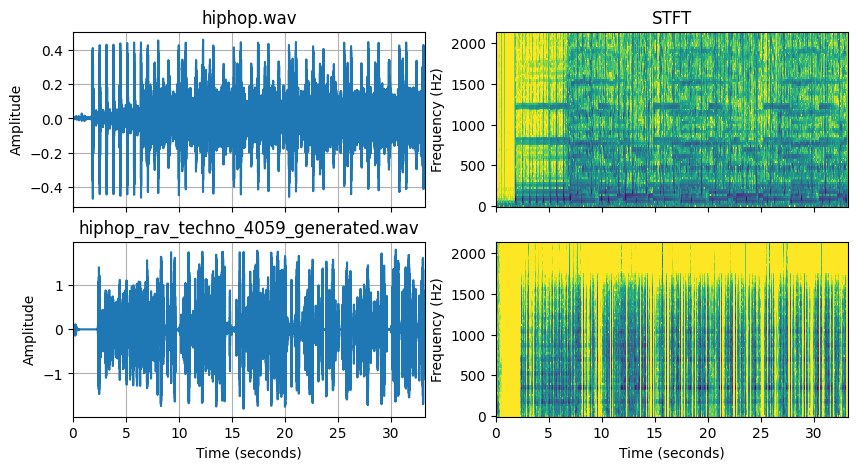

In [141]:
f1, t1, Zxx1 = signal.stft(input_data, fs=sample_rate, nperseg=2048, noverlap=512)
f2, t2, Zxx2 = signal.stft(y, fs=sample_rate, nperseg=2048, noverlap=512)

fig, axs = plt.subplots(2, 2,figsize=(10,5), sharex=True)

axs[0,0].plot(time,input_data)
axs[0,0].set_ylabel("Amplitude")
axs[0,0].grid()
axs[0,0].set_title(input_file.split("/")[-1])
axs[1,0].plot(time,y)
axs[1,0].set_ylabel("Amplitude")
axs[1,0].set_xlabel("Time (seconds)")
axs[1,0].grid()
axs[1,0].set_title(output_file.split("/")[-1])

axs[0,1].pcolormesh(t1, f1[:100], np.abs(li.amplitude_to_db(Zxx1[:100,:],
                                                       ref=np.max)))
axs[1,1].pcolormesh(t2, f2[:100], np.abs(li.amplitude_to_db(Zxx2[:100,:],
                                                       ref=np.max)))
axs[1,1].set_xlabel("Time (seconds)")
axs[0,1].set_title("STFT")
axs[0,1].set_ylabel("Frequency (Hz)")
axs[1,1].set_ylabel("Frequency (Hz)")

## Real-time Audio Geneartion & Processing using Max/MSP

Examples of processing Audio Generation (timbre transfer and latent space manipulation) in real-time with Max/MSP can be found in the provided Max Patch Example and Demo Video in this repository: `'03-rave-audio-synthesis-example.maxpat'` and `'03-maxmsp-rave-demo.mp4'`

The initial template '03-rave-in-max-template.maxpat' was provided by Irini Kalaitzidi ♡; tutorials IRCAM tutorial can be found here: https://www.youtube.com/watch?v=o09BSf9zP-0, and instructions about nn~ installation can be found here:
https://github.com/acids-ircam/nn_tilde

To open the .maxpat file:
- Please make sure you follow the instructions on https://acids-ircam.github.io/nn_tilde/ and https://acids-ircam.github.io/nn_tilde/ to have **MaxMSP** and **nn~** downloaded and installed on your computer
- Place the final trained model (**rav_piano_4069.ts** and **rav_techno_4059.ts**, make sure to rename them to **piano.ts** and **techno.ts** so it aligns with the namings in example maxpat) in `Documents/pretrained_models/`,  which should be created if there is no such folder on your computer
- The source audio (guitar-loop-g-major.wav and piano-115480, copyright free songs obtained online) used in the example are included in `.audio/` in this repositoriy, or use other audio - simply drag them into the maxpat/
- Feel free to play with it!
  